In [1]:
%matplotlib inline
from matplotlib import pyplot as plt
import os
import subprocess
# Because Collab Jupyter Notebooks are headless, we need to launch a simple
# Xserver on DISPLAY :42 to use Mayavi/VTK Rendering
xvfbcommand = "Xvfb :42 -screen 0 1280x1024x24 -auth localhost".split(" ")
subprocess.Popen(['nohup'] + xvfbcommand,
                 stdout=open('/dev/null', 'w'),
                 stderr=open('/tmp/xvfb-logfile.log', 'a'),
                 preexec_fn=os.setpgrp
                 )
os.environ["DISPLAY"] = ":42"
from mayavi import mlab
mlab.init_notebook()

from netCDF4 import Dataset
import numpy as np

KRYPTON = "/data0/project/vortex/lahaye/"

Notebook initialized with x3d backend.


In [2]:
path_data = "luckyto_ebl3D_j485_i513_avg.nc"
path_grid = KRYPTON + "lucky_corgrd.nc"


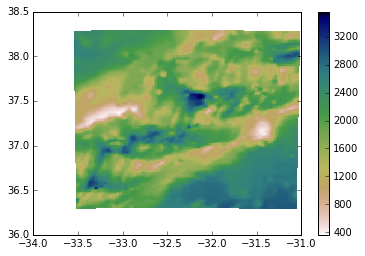

In [3]:
# load data
nc = Dataset(path_data, "r")
ncvar = nc.variables
xi = ncvar['xi'][:]
eta = ncvar['eta'][:]
lon = ncvar['lon'][:]
lat = ncvar['lat'][:]
kebc = ncvar['ebcl'][:]
nc.close()
lonm, latm = lon.mean(axis=0), lat.mean(axis=1)

nc = Dataset(path_grid, "r")
topo = nc.variables['h'][eta,:][:,xi]
nc.close()

plt.pcolormesh(lon, lat, topo, cmap='gist_earth_r')
plt.colorbar()

In [13]:
mlab.figure(size=(600,600))
s = mlab.surf(-topo.T, colormap='gist_earth', warp_scale=0.01)
mlab.view(azimuth=60, elevation=-40, distance=200, focalpoint="auto")
s


In [27]:
mlab.figure(size=(600,600))
b = mlab.contour3d(kebc.T, contours=[3.], transparent=True)
b


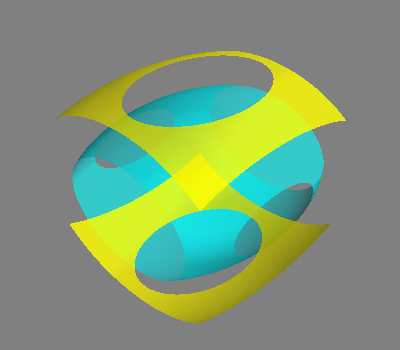

In [20]:
fig = mlab.figure()
mlab.test_contour3d()

In [4]:
mlab.volume_slice?

In [11]:
mlab.figure()
mlab.volume_slice(kebc.T, plane_opacity=0.1)

In [8]:
mlab.figure()
mlab.test_volume_slice()

TypeError: a bytes-like object is required, not 'str'